In [2]:
import numpy as np
import os
import matplotlib.pyplot as plt
from tqdm import tqdm 
from datetime import datetime, timedelta
import rasterio

In [30]:
ndvi_root = np.load('/mnt/storage/huyekgis/brios/datasets/TEST_anninh/ndvi_npy/anninh_ndvi8days.npy')
ndvi_root.shape

(464, 396, 46)

In [15]:
ndvi_root[21, 129, 30]

np.float64(0.5898918509483337)

/tmp/ipykernel_11580/511153715.py:13: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


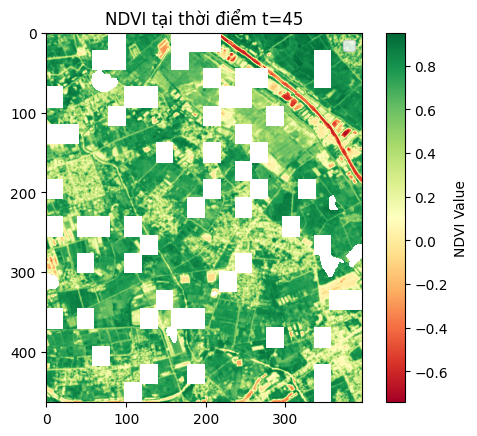

In [31]:
import matplotlib.pyplot as plt
import numpy as np

# Giả sử ndvi_root là mảng NDVI với shape (x, y, t)
# Truy cập NDVI tại pixel (21, 129) cho thời điểm 30
pixel_x, pixel_y, time_t = 21, 129, 45
ndvi_value = ndvi_root[pixel_x, pixel_y, time_t]

# Vẽ NDVI tại thời điểm đã chọn
plt.imshow(ndvi_root[:, :, time_t], cmap='RdYlGn')
plt.colorbar(label="NDVI Value")
plt.title(f"NDVI tại thời điểm t={time_t}")
plt.legend()
plt.show()

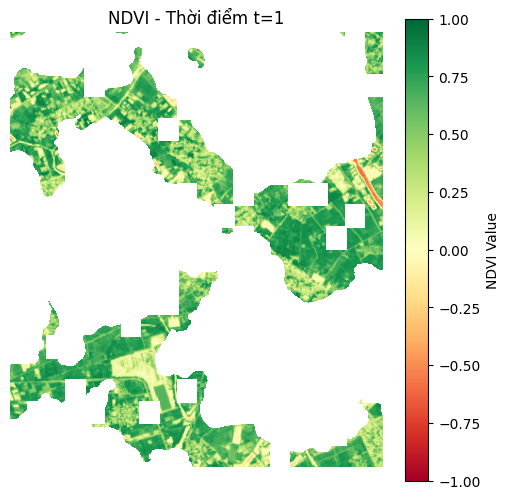

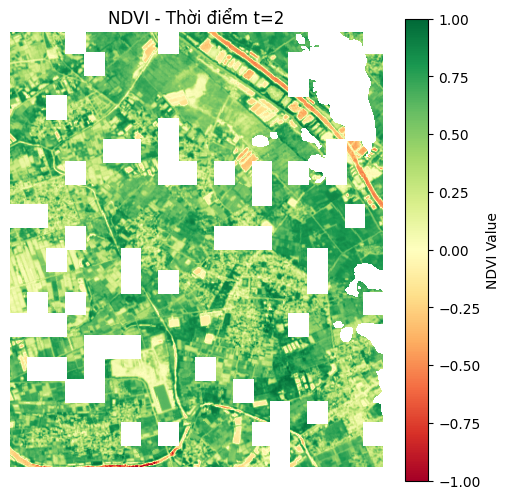

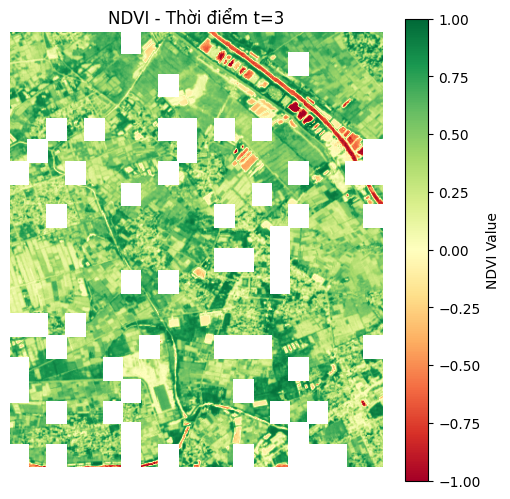

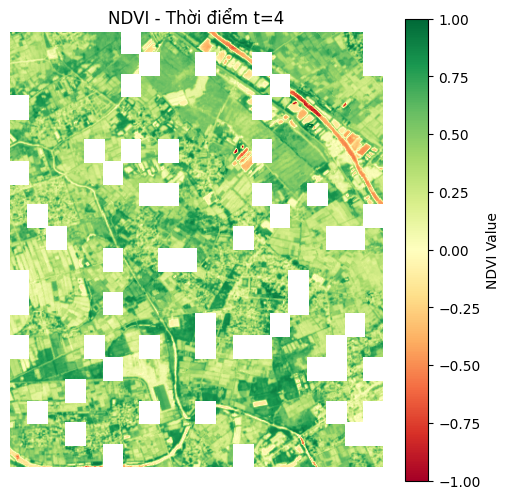

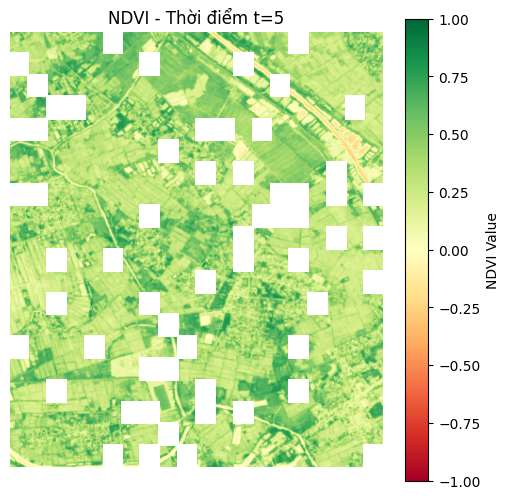

...

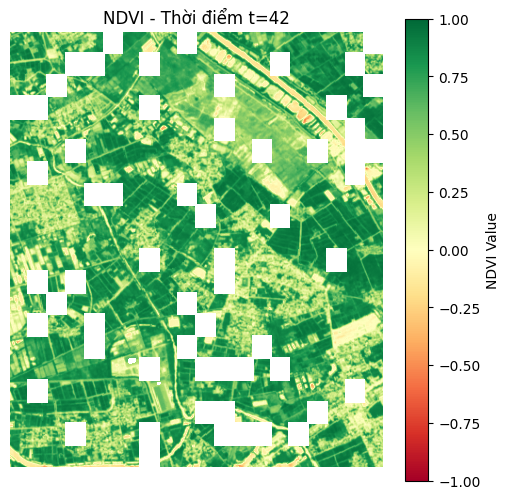

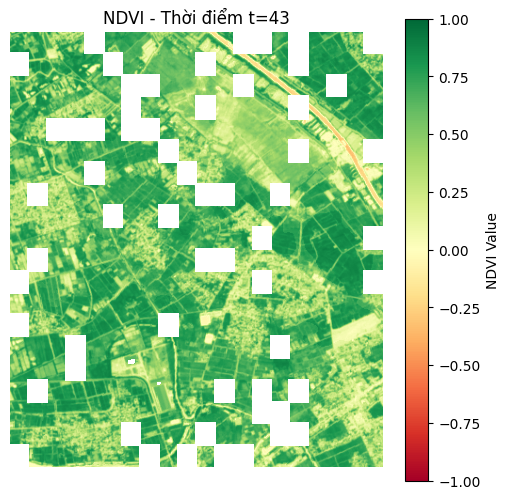

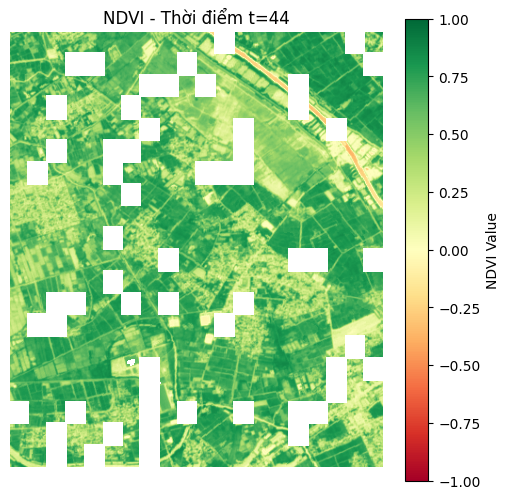

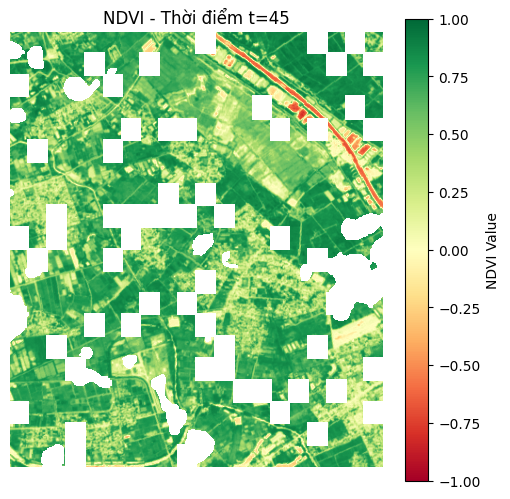

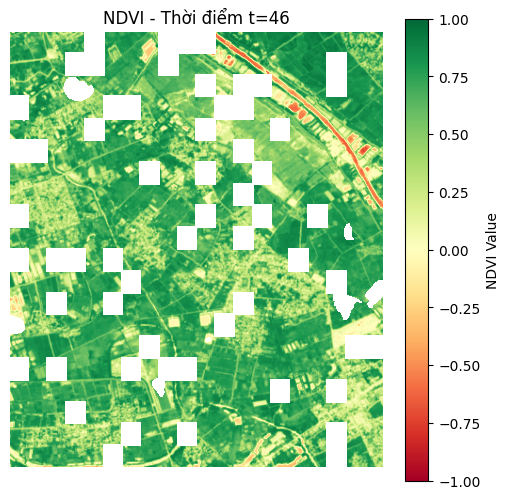

In [32]:
import matplotlib.pyplot as plt
import numpy as np

# Giả sử ndvi_root là mảng NDVI với shape (x, y, t)
num_timesteps = ndvi_root.shape[2]

# Lặp qua từng thời điểm và tạo một figure cho mỗi ảnh
for t in range(num_timesteps):
    plt.figure(figsize=(6, 6))
    plt.imshow(ndvi_root[:, :, t], cmap='RdYlGn', vmin=-1, vmax=1)
    plt.colorbar(label="NDVI Value")
    plt.title(f"NDVI - Thời điểm t={t+1}")
    plt.axis('off')  # Tắt các trục để ảnh rõ ràng hơn
    plt.show()


In [33]:
img1 = np.load('/mnt/storage/huyekgis/brios/BRIOS/results/anninh/brios_base_anninh.npy')
img1.shape

(183744, 46, 1)

In [29]:
import os
import re
import rasterio
import numpy as np
import tifffile as tiff

# Đặt đường dẫn đến thư mục chứa các tệp .tif
folder_path = '/mnt/storage/huyekgis/brios/RAW_TEST_Data/Data4BRIOS_TEST/AnPhus-Pleicu-GiaLai/anphu_rvi_8days'

# Lấy danh sách các tệp .tif trong thư mục
tif_files = [f for f in os.listdir(folder_path) if f.endswith('.tif')]

# Dùng regular expression để trích xuất ngày từ tên tệp
dates = []
for tif_file in tif_files:
    match = re.search(r'(\d{4}-\d{2}-\d{2})', tif_file)  # Tìm ngày theo định dạng 'YYYY-MM-DD'
    if match:
        dates.append(match.group(1))  # Thêm ngày vào danh sách

# Sắp xếp danh sách ngày theo thứ tự tăng dần
dates.sort()

# Đọc metadata từ file gốc
with rasterio.open("/mnt/storage/huyekgis/brios/RAW_TEST_Data/Data4BRIOS_TEST/AnPhus-Pleicu-GiaLai/anphu_ndvi8days/ndvi8days_2023-10-01.tif") as src:
    meta = src.meta

# Giả sử ndvi_root là mảng NDVI với shape (x, y, t)
num_timesteps = 46

# Kiểm tra số lượng ngày có sẵn
assert len(dates) == num_timesteps, "Số ngày không khớp với số thời điểm"

# Lặp qua từng thời điểm và lưu các ảnh với tên tệp dựa trên thứ tự ngày
for t in range(num_timesteps):
    # Tạo tên file cho mỗi ảnh dựa trên ngày
    filename = f"/mnt/storage/huyekgis/brios/RAW_TEST_Data/Data4BRIOS_TEST/AnPhus-Pleicu-GiaLai/results/img_{dates[t]}.tif"
    
    # Sử dụng metadata từ file gốc để lưu lại thông tin metadata cho file mới
    meta.update(count=1, dtype=rasterio.float32)  # Cập nhật số lượng band và kiểu dữ liệu

    # Lưu ảnh dự đoán vào file mới với metadata sao chép
    with rasterio.open(filename, 'w', **meta) as dst:
        dst.write(img1[:, :, t], 1)  # Ghi ảnh vào band đầu tiên


In [44]:
# check meta data cua anh du doan xem co trung voi meta data goc khong
with rasterio.open("") as src:
    print(src.meta)

{'driver': 'GTiff', 'dtype': 'float32', 'nodata': None, 'width': 396, 'height': 464, 'count': 1, 'crs': CRS.from_epsg(4326), 'transform': Affine(8.983152841195215e-05, 0.0, 106.39161134858188,
       0.0, -8.983152841195215e-05, 20.683799248380396)}


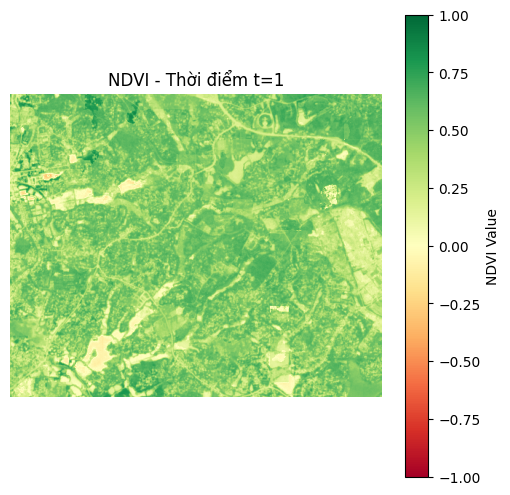

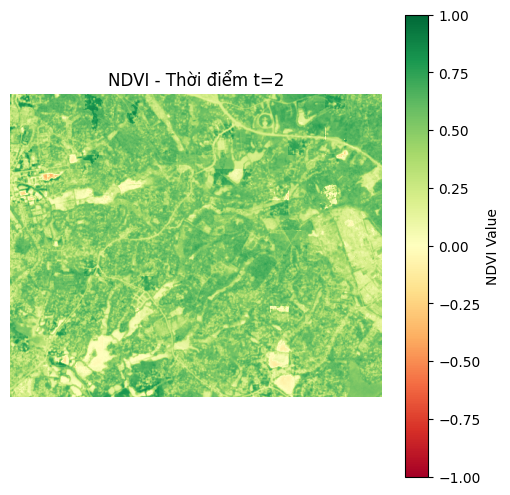

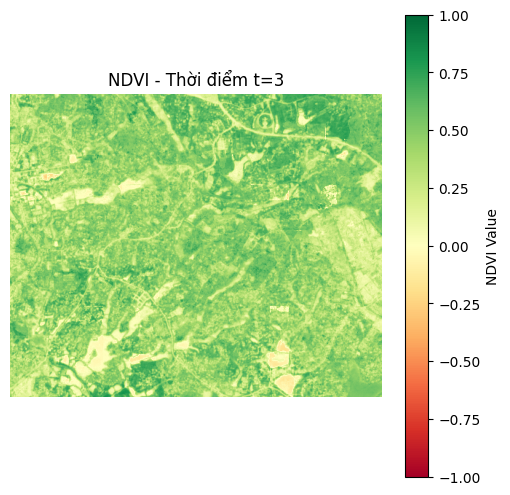

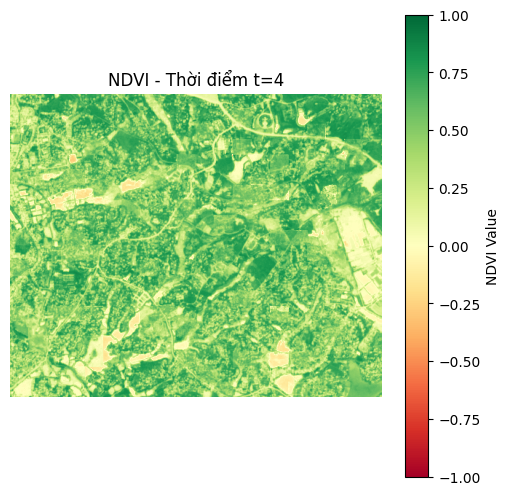

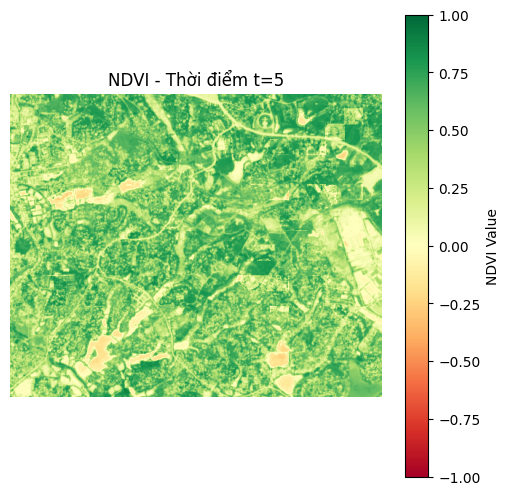

...

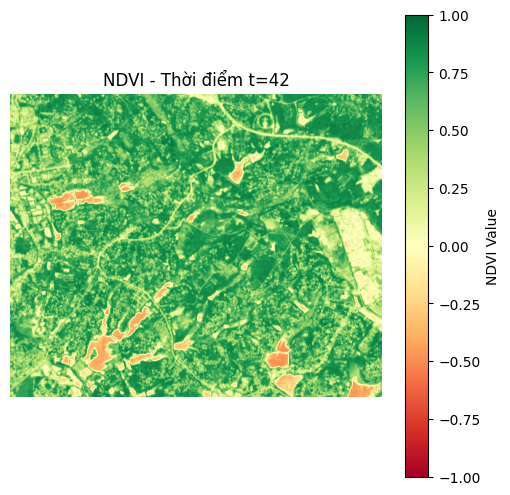

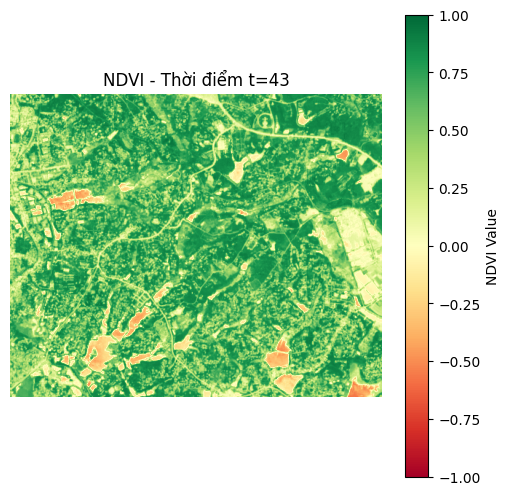

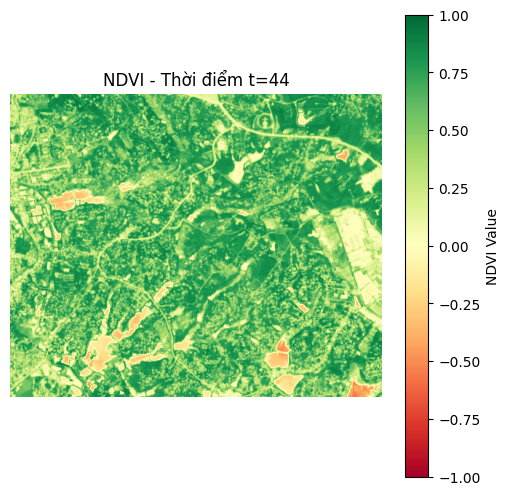

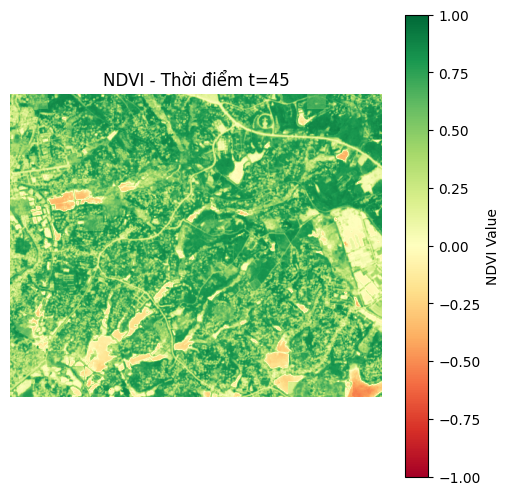

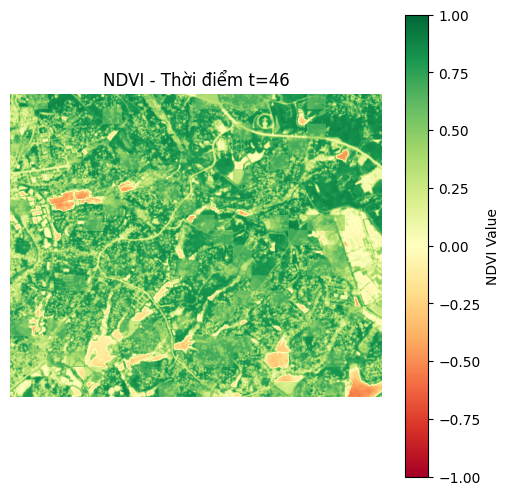

In [24]:
import matplotlib.pyplot as plt
import numpy as np
import tifffile as tiff

# Giả sử ndvi_root là mảng NDVI với shape (x, y, t)
num_timesteps = ndvi_root.shape[2]

# Lặp qua từng thời điểm và tạo một figure cho mỗi ảnh
for t in range(num_timesteps):

    plt.figure(figsize=(6, 6))
    plt.imshow(img1[:, :, t], cmap='RdYlGn', vmin=-1, vmax=1)
    plt.colorbar(label="NDVI Value")
    plt.title(f"NDVI - Thời điểm t={t+1}")
    plt.axis('off')  # Tắt các trục để ảnh rõ ràng hơn
    plt.show()


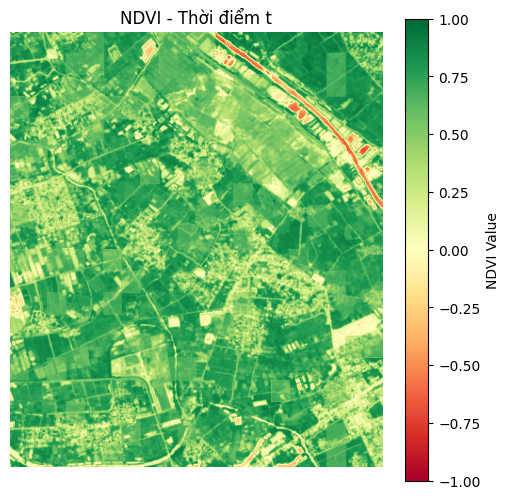

In [45]:
import matplotlib.pyplot as plt
import tifffile as tiff

# Đọc ảnh từ tệp .tif
img = tiff.imread('/mnt/data1tb/brios/Data4BRIOS/AnNinh-QuynhPhu-ThaiBinh/result/img_2023-09-26.tif')  # Thay đổi tên file phù hợp

# Hiển thị ảnh
plt.figure(figsize=(6, 6))
plt.imshow(img, cmap='RdYlGn', vmin=-1, vmax=1)  # Tùy chỉnh colormap và giá trị tối thiểu/tối đa
plt.colorbar(label="NDVI Value")
plt.title("NDVI - Thời điểm t")  # Thay đổi tiêu đề cho phù hợp
plt.axis('off')  # Tắt các trục
plt.show()


In [22]:
ndvi_root_time_series = ndvi_root.reshape(160740, 46)
ndvi_root_time_series.shape

(160740, 46)

In [23]:
time_series_less_null = []
for i in range(16740):
    cnt = 0
    for j in range(46):
        if not np.isnan(ndvi_root_time_series[i, j]):
            cnt += 1
    if cnt >= 32:   
        time_series_less_null.append(i)

# np.save('/mnt/data1tb/BRIOS/data2/anphu_less_null.npy', time_series_less_null)
len(time_series_less_null)

1384

In [24]:
changed_positions_25 = np.load('/mnt/data1tb/brios/BRIOS/datasets/dataTrain/changed_positions_25.npy')

changed_positions_25[1]

array([False, False, False, False, False, False, False,  True, False,
       False, False,  True, False, False, False, False, False, False,
        True, False,  True,  True, False, False, False, False, False,
       False,  True, False, False, False,  True, False, False, False,
       False, False, False, False, False, False, False, False,  True,
       False])

In [57]:
test_25 = np.load('/mnt/data1tb/brios/BRIOS/BRIOS/results/anphu_haiduong/base_brios_attention_anphu_25.npy')

In [58]:
anphu_less_null = np.load('/mnt/data1tb/brios/BRIOS/datasets/dataTrain/anphu_less_null.npy')
anphu_less_null.shape

(1384,)

In [59]:
test_25.shape

(1384, 46, 1)

In [60]:
squared_errors = []
for i in range(test_25.shape[0]):
    for t in range(test_25.shape[1]):
        if changed_positions_25[i, t]:
            y_root = ndvi_root_time_series[[anphu_less_null[i]], t]
            y_pred = test_25[i, t, 0]
            print(f'y root {y_root} y pred {y_pred}')
            squared_errors.append((y_root - y_pred) ** 2)

rmse = np.sqrt(np.mean(squared_errors))

print("RMSE:", rmse)


y root [0.42532909] y pred 0.44587236642837524
y root [0.43296704] y pred 0.44609060883522034
y root [0.19717787] y pred 0.29379093647003174
y root [0.19717787] y pred 0.2969978153705597
y root [0.35159817] y pred 0.33833378553390503
y root [0.27272728] y pred 0.3015405237674713
y root [0.27344027] y pred 0.48188725113868713
y root [0.27344027] y pred 0.47348451614379883
y root [0.41167316] y pred 0.5084589123725891
y root [0.48336449] y pred 0.48386847972869873
y root [0.24235901] y pred 0.37027856707572937
y root [0.2331467] y pred 0.3095749020576477
y root [0.25467497] y pred 0.3562297821044922
y root [0.30307692] y pred 0.3670903444290161
y root [0.40142095] y pred 0.3885522484779358
y root [0.59185058] y pred 0.5941451787948608
y root [0.54158568] y pred 0.5439016222953796
y root [0.41776186] y pred 0.5235306024551392
y root [0.61326861] y pred 0.6008893251419067
y root [0.4798885] y pred 0.4904055595397949
y root [0.68429619] y pred 0.6277148127555847
y root [0.58022296] y pred 0

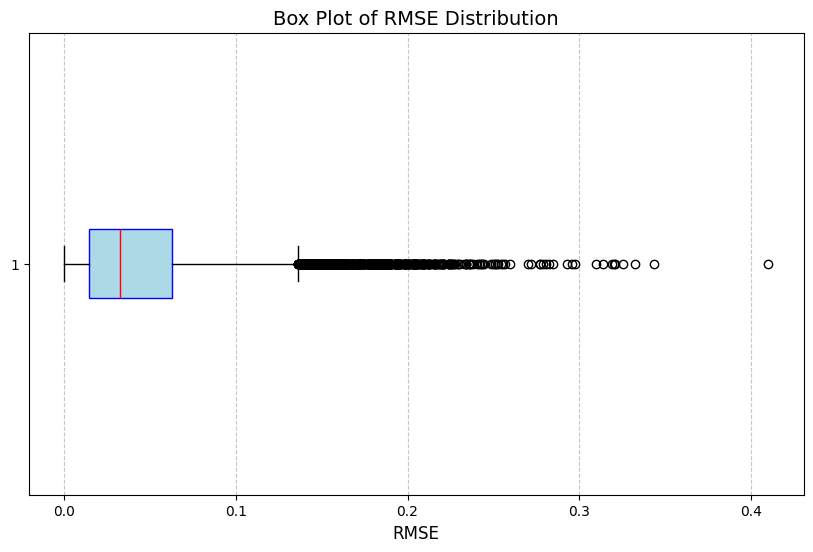

In [61]:
import numpy as np
import matplotlib.pyplot as plt

# Assuming squared_errors đã được tính toán
squared_errors = np.array(squared_errors)

# RMSE cho từng giá trị
rmse_per_point = np.sqrt(squared_errors)

# Vẽ box plot
plt.figure(figsize=(10, 6))
plt.boxplot(rmse_per_point, vert=False, patch_artist=True, 
            boxprops=dict(facecolor="lightblue", color="blue"),
            medianprops=dict(color="red"))

plt.title("Box Plot of RMSE Distribution", fontsize=14)
plt.xlabel("RMSE", fontsize=12)
plt.grid(axis="x", linestyle="--", alpha=0.7)

plt.show()


In [29]:
test_50 = np.load('/mnt/data1tb/brios/BRIOS/BRIOS/results/anphu_haiduong/base_brios_anphu_50.npy')

test_50.shape

(1384, 46, 1)

In [30]:
changed_positions_50 = np.load('/mnt/data1tb/brios/BRIOS/datasets/dataTrain/changed_positions_50.npy')
changed_positions_50.shape

(1384, 46)

In [31]:
squared_errors = []
for i in range(test_50.shape[0]):
    for t in range(test_50.shape[1]):
        if changed_positions_50[i, t]:
            y_root = ndvi_root_time_series[[anphu_less_null[i]], t]
            y_pred = test_50[i, t, 0]
            print(f'y root {y_root} y pred {y_pred}')
            squared_errors.append((y_root - y_pred) ** 2)

rmse = np.sqrt(np.mean(squared_errors))

print("RMSE:", rmse)


y root [0.43852931] y pred 0.43174171447753906
y root [0.4696635] y pred 0.5080418586730957
y root [0.42532909] y pred 0.5193480849266052
y root [0.55950755] y pred 0.4313091039657593
y root [0.34070158] y pred 0.12031830847263336
y root [0.19552609] y pred 0.27172330021858215
y root [0.20591967] y pred 0.24416936933994293
y root [0.22343096] y pred 0.2697219252586365
y root [0.19717787] y pred 0.25954657793045044
y root [0.20403515] y pred 0.28557127714157104
y root [0.24450952] y pred 0.2981797456741333
y root [0.29652864] y pred 0.2823891043663025
y root [0.45704058] y pred 0.34204110503196716
y root [0.36832413] y pred 0.3102351129055023
y root [0.50308371] y pred 0.47971776127815247
y root [0.27344027] y pred 0.3794112503528595
y root [0.56600362] y pred 0.4730713963508606
y root [0.64329475] y pred 0.2688440680503845
y root [0.5400579] y pred 0.26859986782073975
y root [0.48336449] y pred 0.26514771580696106
y root [0.38512555] y pred 0.28249698877334595
y root [0.38512555] y pre

In [35]:
test_75 = np.load('/mnt/data1tb/brios/BRIOS/BRIOS/results/anphu_haiduong/base_brios_anphu_75.npy')

test_75.shape

(1384, 46, 1)

In [38]:
changed_positions_75 = np.load('/mnt/data1tb/brios/BRIOS/datasets/dataTrain/changed_positions_75.npy')
changed_positions_75.shape

(1384, 46)

In [39]:
squared_errors = []
for i in range(test_75.shape[0]):
    for t in range(test_75.shape[1]):
        if changed_positions_75[i, t]:
            y_root = ndvi_root_time_series[[anphu_less_null[i]], t]
            y_pred = test_75[i, t, 0]
            print(f'y root {y_root} y pred {y_pred}')
            squared_errors.append((y_root - y_pred) ** 2)

rmse = np.sqrt(np.mean(squared_errors))

print("RMSE:", rmse)


y root [0.43852931] y pred 0.427701473236084
y root [0.4696635] y pred 0.38271674513816833
y root [0.3755179] y pred 0.38024306297302246
y root [0.55950755] y pred 0.4774409532546997
y root [0.43296704] y pred 0.44508278369903564
y root [0.36270413] y pred 0.3904362916946411
y root [0.34070158] y pred 0.3391924500465393
y root [0.34070158] y pred 0.3408094346523285
y root [0.19552609] y pred 0.2734122574329376
y root [0.20591967] y pred 0.23272418975830078
y root [0.22343096] y pred 0.2549268901348114
y root [0.19717787] y pred 0.2767360806465149
y root [0.19717787] y pred 0.2555016875267029
y root [0.24450952] y pred 0.27057206630706787
y root [0.35159817] y pred 0.2995262145996094
y root [0.392658] y pred 0.30142736434936523
y root [0.45704058] y pred 0.29523420333862305
y root [0.27272728] y pred 0.27589622139930725
y root [0.27272728] y pred 0.2771102786064148
y root [0.36832413] y pred 0.32594868540763855
y root [0.52253461] y pred 0.41336381435394287
y root [0.50308371] y pred 0.

(344, 443)


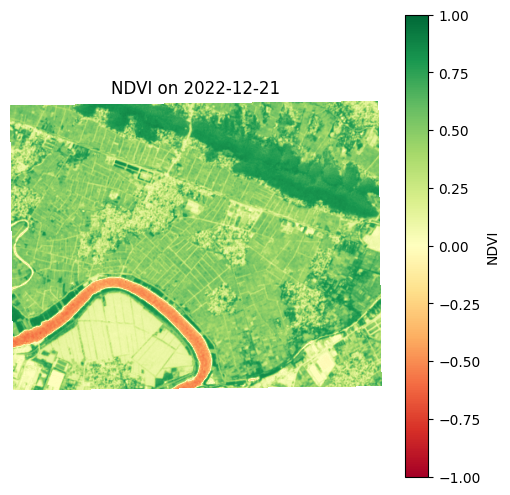

(344, 443)


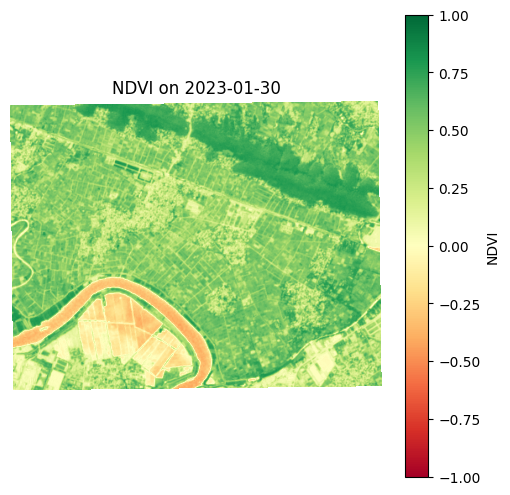

In [120]:
ndvi_noncloud11 = []
# non_cloud = ['2022-10-12', '2022-11-06', '2022-12-19', '2022-12-21', '2022-12-24', '2023-01-25', '2023-01-30', '2023-05-18']
non_cloud = ['2022-12-21', '2023-01-30']
folder_path = '/mnt/data1tb/brios/BRIOS/datasets/data2/ndvi_noncloud/'

vmin = -1
vmax = 1

for date in non_cloud:
    file_path = f"{folder_path}ndvinoncloud_{date}.tif"
    
    with rasterio.open(file_path) as src:
        ndvi_data11 = src.read(1) 
        ndvi_noncloud11.append(ndvi_data11)
        print(ndvi_data11.shape)
    
    plt.figure(figsize=(6, 6))
    plt.imshow(ndvi_data11, cmap='RdYlGn', vmin=vmin, vmax=vmax)
    plt.colorbar(label="NDVI")
    plt.title(f"NDVI on {date}")
    plt.axis('off')
    plt.show()

ndvi_noncloud = np.stack(ndvi_noncloud11, axis=0).transpose(1, 2, 0)


In [111]:
ndvi_noncloud

array([[[nan, nan],
        [nan, nan],
        [nan, nan],
        ...,
        [nan, nan],
        [nan, nan],
        [nan, nan]],

       [[nan, nan],
        [nan, nan],
        [nan, nan],
        ...,
        [nan, nan],
        [nan, nan],
        [nan, nan]],

       [[nan, nan],
        [nan, nan],
        [nan, nan],
        ...,
        [nan, nan],
        [nan, nan],
        [nan, nan]],

       ...,

       [[nan, nan],
        [nan, nan],
        [nan, nan],
        ...,
        [nan, nan],
        [nan, nan],
        [nan, nan]],

       [[nan, nan],
        [nan, nan],
        [nan, nan],
        ...,
        [nan, nan],
        [nan, nan],
        [nan, nan]],

       [[nan, nan],
        [nan, nan],
        [nan, nan],
        ...,
        [nan, nan],
        [nan, nan],
        [nan, nan]]], dtype=float32)

In [88]:
test=np.load('/mnt/data1tb/brios/BRIOS/BRIOS/results/anphu_haiduong/test.npy')

In [89]:
test.shape

(160740, 46, 1)

In [93]:
for i in range(test.shape[0]):
    y_pred = test[i, 10, 0]
    y_noncloud = 

array([0.44397563, 0.5097451 , 0.52882946, ..., 0.4544236 , 0.47175816,
       0.66507876], dtype=float32)

In [1]:
import rasterio

In [15]:
with rasterio.open('/mnt/storage/huyekgis/brios/Mask_NgheAn.tif') as f:
    data = f.read(1)

In [28]:
with rasterio.open('/mnt/storage/huyekgis/brios/NgheAn1.tif') as f: 
    src = f.meta

In [29]:
src

{'driver': 'GTiff',
 'dtype': 'uint8',
 'nodata': None,
 'width': 4162,
 'height': 4384,
 'count': 3,
 'crs': CRS.from_epsg(3857),
 'transform': Affine(1.25, 0.0, 11736863.75,
        0.0, -1.25, 2151716.25)}

In [23]:
import numpy as np

In [25]:
bin_arr = np.where(data < 1, 0, 1)

In [30]:
with rasterio.open('/mnt/storage/huyekgis/brios/NgheAn1_bin_mask.tif', 'w', **src) as dst:
    dst.write(bin_arr.astype('uint8'), 1)

In [26]:
bin_arr

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]])

In [17]:
import matplotlib.pyplot as plt 

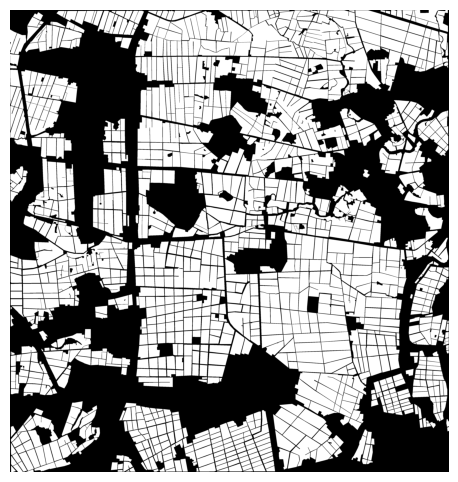

In [27]:
plt.figure(figsize=(6, 6))
plt.imshow(bin_arr, cmap='gray', vmin=0, vmax=1)
plt.axis('off')
plt.show()

In [31]:
import geopandas as gpd
from shapely.geometry import Polygon, LineString
import rasterio
from rasterio.features import rasterize
import numpy as np
from rasterio.transform import from_origin

# Bước 1: Đọc file shapefile (Polygon)
polygon_gdf = gpd.read_file("/mnt/storage/huyekgis/brios/NA1.shp")

# Chuyển Polygon sang Polyline
def polygon_to_polyline(geometry):
    if isinstance(geometry, Polygon):
        return LineString(geometry.exterior.coords)  # Lấy đường viền ngoài
    return geometry

polyline_gdf = polygon_gdf.copy()
polyline_gdf['geometry'] = polyline_gdf['geometry'].apply(polygon_to_polyline)

# Bước 2: Rasterize Polyline thành binary array
# Định nghĩa kích thước raster và transform
width, height = 4162, 4384  # Kích thước ảnh đầu ra
x_min, y_min, x_max, y_max = polyline_gdf.total_bounds
transform = from_origin(x_min, y_max, (x_max - x_min) / width, (y_max - y_min) / height)

# Chuyển đổi polyline thành binary raster
shapes = ((geom, 1) for geom in polyline_gdf.geometry)
binary_array = rasterize(shapes, out_shape=(height, width), transform=transform, fill=0, dtype='uint8')

# Bước 3: Lưu binary array thành file TIFF
metadata = {
    'driver': 'GTiff',
    'dtype': 'uint8',
    'width': binary_array.shape[1],
    'height': binary_array.shape[0],
    'count': 1,
    'crs': polyline_gdf.crs,  # Hệ tọa độ từ shapefile
    'transform': transform,
}

with rasterio.open("polyline_binary_output.tif", "w", **metadata) as dst:
    dst.write(binary_array, 1)

print("Tệp TIFF nhị phân đã được lưu thành công!")


Tệp TIFF nhị phân đã được lưu thành công!


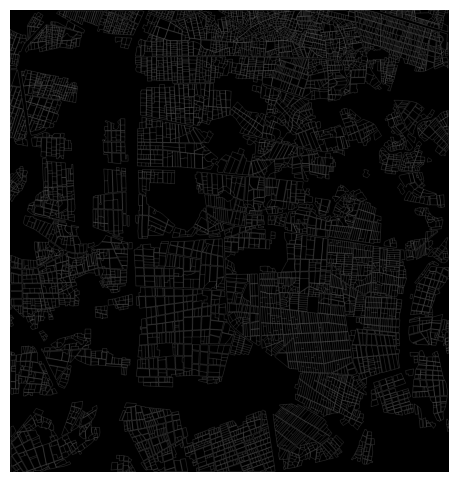

In [32]:
plt.figure(figsize=(6, 6))
plt.imshow(binary_array, cmap='gray', vmin=0, vmax=1)
plt.axis('off')
plt.show()